<a href="https://colab.research.google.com/github/Ayansingha22/Face_Mask_Detection/blob/main/Face_Mask_Datection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle

In [ ]:
# configuring the path of Kaggle.json file
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Importing face mask dataset

In [ ]:
#API to fetch dataset from kaggle
!kaggle datasets download -d omkargurav/face-mask-dataset

 97% 159M/163M [00:01<00:00, 177MB/s]
100% 163M/163M [00:01<00:00, 142MB/s]


In [ ]:
#Extracting the compressed dataset
from zipfile import ZipFile
dataset = '/content/face-mask-dataset.zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [ ]:
!ls

data  face-mask-dataset.zip  kaggle.json  sample_data


Importing the libraries


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image
from sklearn.model_selection import train_test_split

In [ ]:
with_mask_files = os.listdir('/content/data/with_mask')
print(with_mask_files[0:5])
print(with_mask_files[-5:])

['with_mask_1035.jpg', 'with_mask_468.jpg', 'with_mask_1458.jpg', 'with_mask_488.jpg', 'with_mask_1716.jpg']
['with_mask_1947.jpg', 'with_mask_3403.jpg', 'with_mask_2557.jpg', 'with_mask_1664.jpg', 'with_mask_3110.jpg']


In [ ]:
without_mask_files = os.listdir('/content/data/without_mask')
print(without_mask_files[0:5])
print(without_mask_files[-5:])

['without_mask_1707.jpg', 'without_mask_456.jpg', 'without_mask_1646.jpg', 'without_mask_2441.jpg', 'without_mask_338.jpg']
['without_mask_2658.jpg', 'without_mask_2856.jpg', 'without_mask_3583.jpg', 'without_mask_2951.jpg', 'without_mask_1666.jpg']


In [ ]:
print('No of with mask images', len(with_mask_files))
print('No of without mask images', len(without_mask_files))

No of with mask images 3725
No of without mask images 3828


Creating labels for the two class of images



with mask --> 1
without mask --> 0

In [ ]:
#creating the labels
with_mask_labels = [1]*len(with_mask_files)
without_mask_labels = [0]*len(without_mask_files)

In [ ]:
print(with_mask_labels[0:5])
print(without_mask_labels[0:5])

[1, 1, 1, 1, 1]
[0, 0, 0, 0, 0]


In [ ]:
labels = with_mask_labels + without_mask_labels

print(len(labels))
print(labels[0:5])
print(labels[-5:])

7553
[1, 1, 1, 1, 1]
[0, 0, 0, 0, 0]


Displaying the images

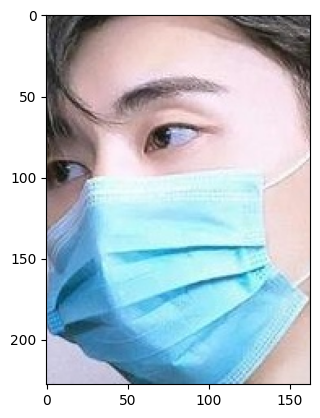

In [ ]:
#displaying with mask image
img = mpimg.imread('/content/data/with_mask/with_mask_1545.jpg')
imgplot = plt.imshow(img)
plt.show()

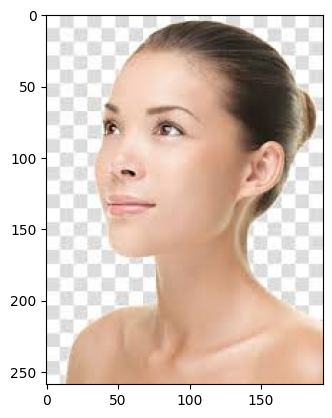

In [ ]:
#displaying without mask image
img = mpimg.imread('/content/data/without_mask/without_mask_2925.jpg')
imgplot = plt.imshow(img)
plt.show()

Image Processing

1. Resizing the images
2. Converting the images to numpy arrays

In [ ]:
#convert images to numpy arrays
with_mask_path = '/content/data/with_mask/'

data = []
for img_file in with_mask_files:
  image = Image.open(with_mask_path + img_file)
  image = image.resize((128,128))
  image = image.convert('RGB')
  image = np.array(image)
  data.append(image)

without_mask_path = '/content/data/without_mask/'

for img_file in without_mask_files:
  image = Image.open(without_mask_path + img_file)
  image = image.resize((128,128))
  image = image.convert('RGB')
  image = np.array(image)
  data.append(image)

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
type(data)

list

In [ ]:
len(data)

7553

In [ ]:
data[0]

array([[[247, 254, 246],
        [251, 254, 248],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [249, 255, 252]],

       [[252, 253, 250],
        [235, 229, 227],
        [186, 169, 169],
        ...,
        [190, 165, 166],
        [183, 161, 160],
        [205, 195, 190]],

       [[255, 255, 255],
        [220, 204, 204],
        [125,  87,  85],
        ...,
        [152, 102, 104],
        [138,  94,  93],
        [181, 154, 150]],

       ...,

       [[255, 255, 254],
        [206, 207, 212],
        [  9,  11,  29],
        ...,
        [  9,   9,  39],
        [  2,   1,  24],
        [103, 100, 120]],

       [[255, 255, 254],
        [207, 207, 210],
        [  9,  10,  23],
        ...,
        [  5,   6,  33],
        [  0,   0,  16],
        [103, 101, 117]],

       [[255, 255, 255],
        [206, 207, 209],
        [  8,  10,  16],
        ...,
        [  3,   4,  29],
        [  0,   0,  12],
        [103, 102, 113]]

In [ ]:
type(data[0])

numpy.ndarray

In [ ]:
data[0].shape

(128, 128, 3)

In [ ]:
#converting image list and label list to numpy arrays

X = np.array(data)
Y = np.array(labels)

In [ ]:
type(X)

numpy.ndarray

In [ ]:
type(Y)

numpy.ndarray

In [ ]:
print(X.shape)
print(Y.shape)

(7553, 128, 128, 3)
(7553,)


Train Test Split

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 2)

In [ ]:
print(X.shape, X_train.shape, X_test.shape)

(7553, 128, 128, 3) (6042, 128, 128, 3) (1511, 128, 128, 3)


In [ ]:
#scaling the data
X_train_scaled = X_train/255
X_test_scaled = X_test/255

In [ ]:
X_train[0]

array([[[ 30,  30,  30],
        [ 28,  28,  28],
        [ 28,  28,  28],
        ...,
        [ 37,  37,  37],
        [ 40,  40,  40],
        [ 40,  40,  40]],

       [[ 30,  30,  30],
        [ 28,  28,  28],
        [ 29,  29,  29],
        ...,
        [ 38,  38,  38],
        [ 40,  40,  40],
        [ 39,  39,  39]],

       [[ 31,  31,  31],
        [ 31,  31,  31],
        [ 30,  30,  30],
        ...,
        [ 36,  36,  36],
        [ 36,  36,  36],
        [ 36,  36,  36]],

       ...,

       [[ 74,  88, 101],
        [ 72,  86,  98],
        [ 62,  74,  86],
        ...,
        [150, 131, 117],
        [120, 104,  94],
        [ 63,  50,  42]],

       [[ 79,  93, 105],
        [ 77,  91, 101],
        [ 64,  76,  88],
        ...,
        [153, 134, 119],
        [124, 108,  96],
        [ 66,  53,  45]],

       [[ 79,  93, 104],
        [ 75,  89, 100],
        [ 63,  76,  86],
        ...,
        [154, 135, 120],
        [125, 110,  97],
        [ 67,  54,  46]]

In [ ]:
X_train_scaled[0]

array([[[0.11764706, 0.11764706, 0.11764706],
        [0.10980392, 0.10980392, 0.10980392],
        [0.10980392, 0.10980392, 0.10980392],
        ...,
        [0.14509804, 0.14509804, 0.14509804],
        [0.15686275, 0.15686275, 0.15686275],
        [0.15686275, 0.15686275, 0.15686275]],

       [[0.11764706, 0.11764706, 0.11764706],
        [0.10980392, 0.10980392, 0.10980392],
        [0.11372549, 0.11372549, 0.11372549],
        ...,
        [0.14901961, 0.14901961, 0.14901961],
        [0.15686275, 0.15686275, 0.15686275],
        [0.15294118, 0.15294118, 0.15294118]],

       [[0.12156863, 0.12156863, 0.12156863],
        [0.12156863, 0.12156863, 0.12156863],
        [0.11764706, 0.11764706, 0.11764706],
        ...,
        [0.14117647, 0.14117647, 0.14117647],
        [0.14117647, 0.14117647, 0.14117647],
        [0.14117647, 0.14117647, 0.14117647]],

       ...,

       [[0.29019608, 0.34509804, 0.39607843],
        [0.28235294, 0.3372549 , 0.38431373],
        [0.24313725, 0

Building a Convulational Neural Network (CNN)

In [ ]:
import tensorflow as tf
from tensorflow import keras

In [ ]:
num_of_classes = 2

model = keras.Sequential()
model.add(keras.layers.Conv2D(32, kernel_size = (3,3), activation = 'relu', input_shape = (128, 128, 3)))
model.add(keras.layers.MaxPooling2D(pool_size = (2,2)))

model.add(keras.layers.Conv2D(64, kernel_size = (3,3), activation = 'relu'))
model.add(keras.layers.MaxPooling2D(pool_size = (2,2)))

model.add(keras.layers.Flatten())

model.add(keras.layers.Dense(128, activation = 'relu'))
model.add(keras.layers.Dropout(0.5))

model.add(keras.layers.Dense(64, activation = 'relu'))
model.add(keras.layers.Dropout(0.5))

model.add(keras.layers.Dense(num_of_classes, activation = 'sigmoid'))

In [ ]:
#compile the neural network
model.compile(optimizer = 'adam', loss = 'sparse_categorical_crossentropy', metrics = ['acc'])

In [ ]:
#training the neural network
history = model.fit(X_train_scaled, Y_train, validation_split = 0.1, epochs = 5)

Epoch 1/5
170/170 [==============================] - 20s 46ms/step - loss: 0.4388 - acc: 0.8135 - val_loss: 0.2725 - val_acc: 0.8810
Epoch 2/5
170/170 [==============================] - 3s 17ms/step - loss: 0.2809 - acc: 0.8900 - val_loss: 0.2274 - val_acc: 0.8959
Epoch 3/5
170/170 [==============================] - 3s 17ms/step - loss: 0.2260 - acc: 0.9113 - val_loss: 0.2027 - val_acc: 0.9058
Epoch 4/5
170/170 [==============================] - 3s 19ms/step - loss: 0.1833 - acc: 0.9314 - val_loss: 0.2169 - val_acc: 0.9256
Epoch 5/5
170/170 [==============================] - 3s 17ms/step - loss: 0.1516 - acc: 0.9406 - val_loss: 0.2161 - val_acc: 0.9273


Model Evaluation

In [ ]:
loss, accuracy = model.evaluate(X_test_scaled, Y_test)
print('Test Accuracy=', accuracy)

48/48 [==============================] - 1s 11ms/step - loss: 0.2130 - acc: 0.9219
Test Accuracy= 0.9219059944152832


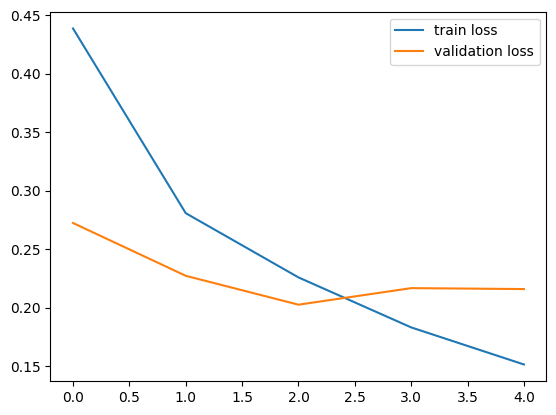

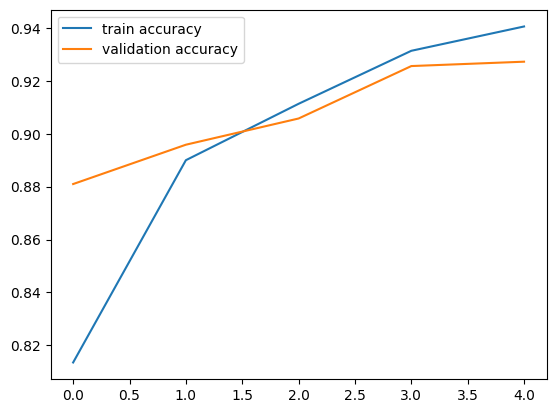

In [ ]:
h = history

#plot the loss value
plt.plot(h.history['loss'], label = 'train loss')
plt.plot(h.history['val_loss'], label = 'validation loss')
plt.legend()
plt.show()

#plot the accuracy value
plt.plot(h.history['acc'], label = 'train accuracy')
plt.plot(h.history['val_acc'], label = 'validation accuracy')
plt.legend()
plt.show()

Prediction system


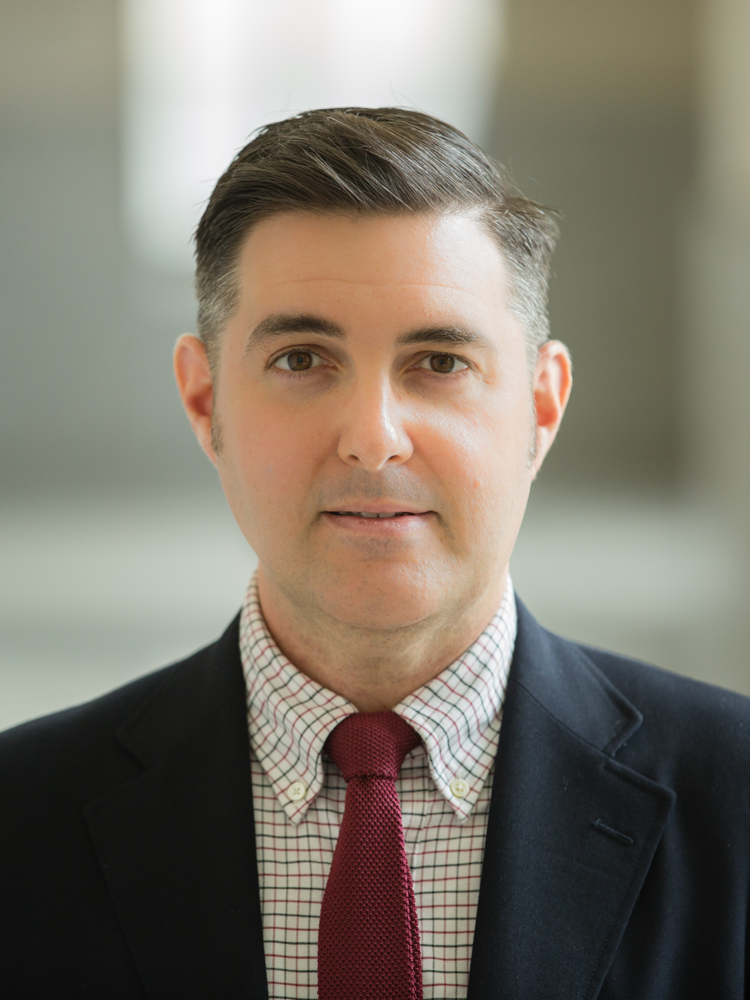

1/1 [==============================] - 0s 29ms/step
[[0.21551915 0.6601226 ]]
1
Person is wearing a mask


In [ ]:
input_image_path = input('Path of the image to be predicted:')
input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resized = cv2.resize(input_image, (128, 128))

input_image_scaled = input_image_resized/255

input_image_reshaped = np.reshape(input_image_scaled, [1,128,128,3])

input_prediction = model.predict(input_image_reshaped)
print(input_prediction)

input_prediction_label = np.argmax(input_prediction)
print(input_prediction_label)


if input_prediction_label == 1:
  print('Person is wearing a mask')
else:
  print('Person not wearing a mask')

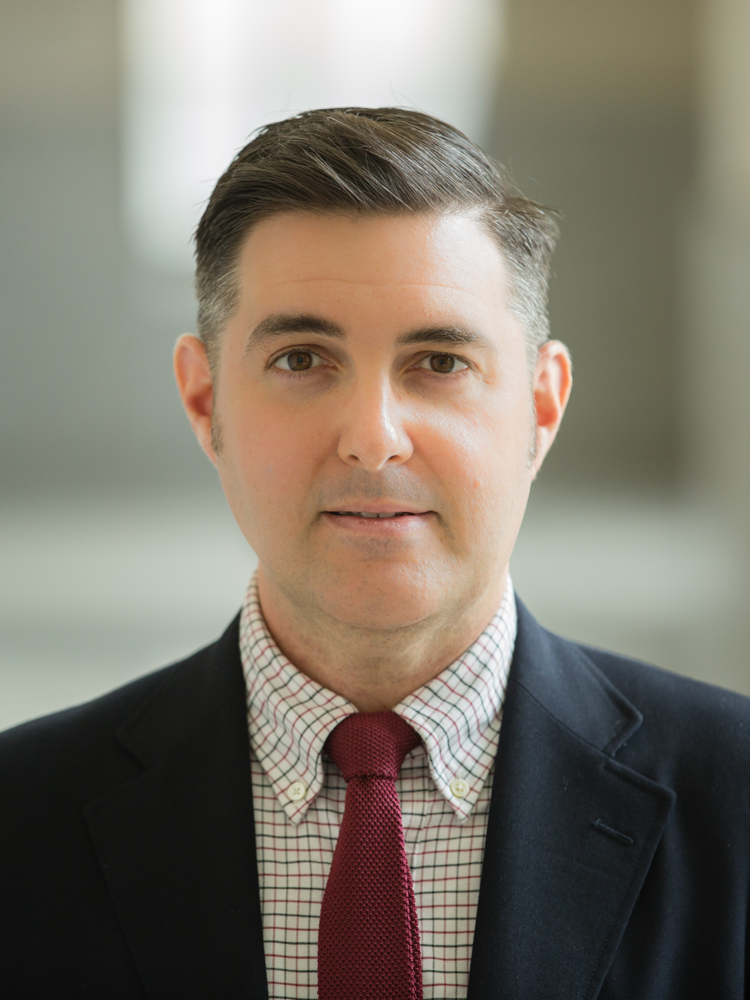

1/1 [==============================] - 0s 62ms/step
[[0.21551915 0.6601226 ]]
1
Person is wearing a mask
